#  Alternative ways of masking - KDTree


In addition to convolutional techniques, GRIDGEN supports masks created using KDTree-based neighbour counting and Self-Organizing Maps (SOM).

We will test derive cancer stroma with both SOM and KDTree and find identify γδ T cell regions using KDtree approaches in Xenium CRC data.

In [1]:
%load_ext autoreload

import os 
import sys
import time
import logging
import re
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import json
import anndata as ad
import scanpy as sc
import squidpy as sq
from natsort import natsorted
import matplotlib.colors as mcolors
np.random.seed(42)
import cv2
import copy
import seaborn as sns
from skimage.measure import label
from matplotlib import patches
sys.path.append(os.path.dirname(os.getcwd()))
from gridgene import get_arrays as ga
from gridgene import contours, get_masks 
from gridgene.mask_properties import MaskAnalysisPipeline, MaskDefinition,MorphologyExtractor
from gridgene.binsom import GetBins, GetContour
from helper_plot import parse_dapi, draw_categorical_json,plot_TRGC_TRDC_points_polygons, plot_TRGC_TRDC_points_contours,draw_categorical_mask_from_tiff,plot_TRGC_TRDC_points_mask

/home/martinha/miniconda3/envs/GRIDGEN/lib/python3.11/site-packages/dask/dataframe/__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
/home/martinha/miniconda3/envs/GRIDGEN/lib/python3.11/site-packages/anndata/utils.py:434: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)


define the logger :  can be None, and is set to INFO

In [2]:
# define the logger :  can be None, and is set to INFO
# Custom logger setup
logger = logging.getLogger('contour_logger')
handler = logging.StreamHandler()
formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')
handler.setFormatter(formatter)
logger.addHandler(handler)
logger.setLevel(logging.INFO)

Get the files

In [3]:
xenium_path =  '../../xenium_data/HLA/GD_TMA1_S3/fov_filtered'

to_exclude = [
    'TMA1_Selection14_filtered.csv' , # little tumour
    'TMA1_Selection15_filtered.csv', # tonsil
    'TMA1_Selection18_filtered.csv' , # normal
    'TMA1_Selection24_filtered.csv', # tonsl 
    'TMA1_Selection27_filtered.csv', # low quality
    'TMA1_Selection32_filtered.csv', # low quality
    'TMA1_Selection33_filtered.csv', # low quality
             ]
files_tma1 = os.listdir(xenium_path)
files = [os.path.join(xenium_path, file) for file in files_tma1 if file not in to_exclude]
print(len(files))

20


***Neighbour counting based cancer stroma identification***

The KD-tree algorithm, a space-partitioning structure, efficiently organizes points in multidimensional space and is commonly used to accelerate nearest-neighbour searches in local neighbourhood analysis. To exemplify this approach, we derived tumour and stromal regions (Supplementary Figure 2D) by calculating, for each point, the number of neighbouring transcripts within a 10 μm radius — both across the full set of genes and a cancer-specific gene set. Points with a high number of cancer gene neighbours were classified as cancer regions, while areas lacking nearby transcripts were designated as empty or stromal. 

Because this computation is performed on a per-point basis, the KD-tree-based method is generally slower than convolutional approaches, particularly for large datasets. However, it can be effective for smaller regions or targeted analyses, where its higher resolution and point-level granularity may be advantageous. 

Use an example file

In [4]:
# we will do for a single file 
file_csv = files[7]
filename = os.path.basename(file_csv).split('.')[0] # Extract the filename without extension
name_file = '_'.join(filename.split('_')[:2])# Extract the desired part

df_total = pd.read_csv(file_csv)
df_total = df_total[['x_location', 'y_location', 'feature_name']]
df_total = df_total.rename(columns={'feature_name': 'target'})
df_total = df_total[~df_total['target'].str.contains('System|egative')]
df_total['X'] = df_total['x_location'] - min(df_total['x_location'])
df_total['Y'] = df_total['y_location'] - min(df_total['y_location'])

n_genes = len(df_total['target'].unique())
height = int(max(df_total['X'])) + 1
width = int(max(df_total['Y'])) + 1

print(f'n genes: {n_genes}')
print(f'shape: {height}, {width}')
print(f'n hits {len(df_total)}')

n genes: 480
shape: 1809, 1769
n hits 4433228


Plot the transcript points for cancer and stroma

In [5]:
target_tum = ['EPCAM', 'SMIM22','CLDN3', 'KRT18','LGALS4', 'KRT8', 'ELF3','TSPAN8', 'STMN1', 'CD47', 'MYC', 'LGALS3'] 
df_subset_tum = df_total[df_total['target'].isin(target_tum)]

/tmp/ipykernel_4069310/3341716541.py:24: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/home/martinha/miniconda3/envs/GRIDGEN/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


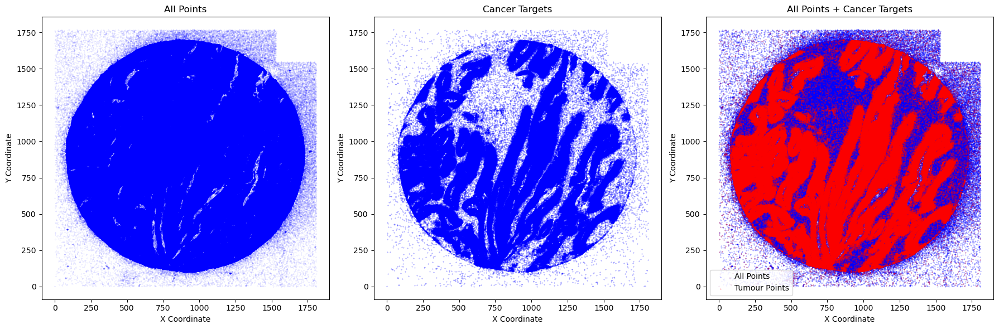

In [6]:
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plot 1: All points
axes[0].scatter(df_total['X'], df_total['Y'], c='blue', alpha=0.6, s=0.01)
axes[0].set_title('All Points')
axes[0].set_xlabel('X Coordinate')
axes[0].set_ylabel('Y Coordinate')

# Plot 2: Tumour subset
axes[1].scatter(df_subset_tum['X'], df_subset_tum['Y'], c='blue', alpha=0.6, s=0.1)
axes[1].set_title('Cancer Targets')
axes[1].set_xlabel('X Coordinate')
axes[1].set_ylabel('Y Coordinate')

# Plot 3: Overlay
axes[2].scatter(df_total['X'], df_total['Y'], c='blue', alpha=0.6, s=0.1, label='All Points')
axes[2].scatter(df_subset_tum['X'], df_subset_tum['Y'], c='red', alpha=0.6, s=0.1, label='Tumour Points')
axes[2].set_title('All Points + Cancer Targets')
axes[2].set_xlabel('X Coordinate')
axes[2].set_ylabel('Y Coordinate')
axes[2].legend()

# Adjust layout
plt.tight_layout()
plt.show()

First we will get all neighborhood points to be able to identify tissue/empty regions.
We will inquiry all points in a max distance of 10 pixels

2025-06-18 14:47:50,271 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:48:37,998 - gridgen.contours.empty - INFO - get_kdt_dist took 47.7267 seconds
2025-06-18 14:48:38,044 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0453 seconds


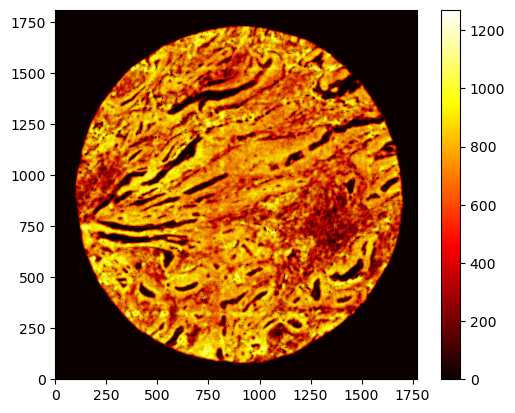

In [7]:
CEmpty = contours.KDTreeContours(df_total[['target', 'X', 'Y']], contour_name='empty', 
                                height=height, width=width)

CEmpty.get_kdt_dist(radius = 10) # max distance of 10 
array_total_nei = CEmpty.get_neighbour_array() # array 2D of the neighboors per point

plt.imshow(array_total_nei, cmap="hot", origin="lower")
plt.colorbar()
plt.show()

we can use this values to derive the contours, using instead of the local sum from convolutional sum the neighborhood points

2025-06-18 14:48:38,751 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 42
2025-06-18 14:48:38,752 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 42
2025-06-18 14:48:38,759 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.3561 seconds


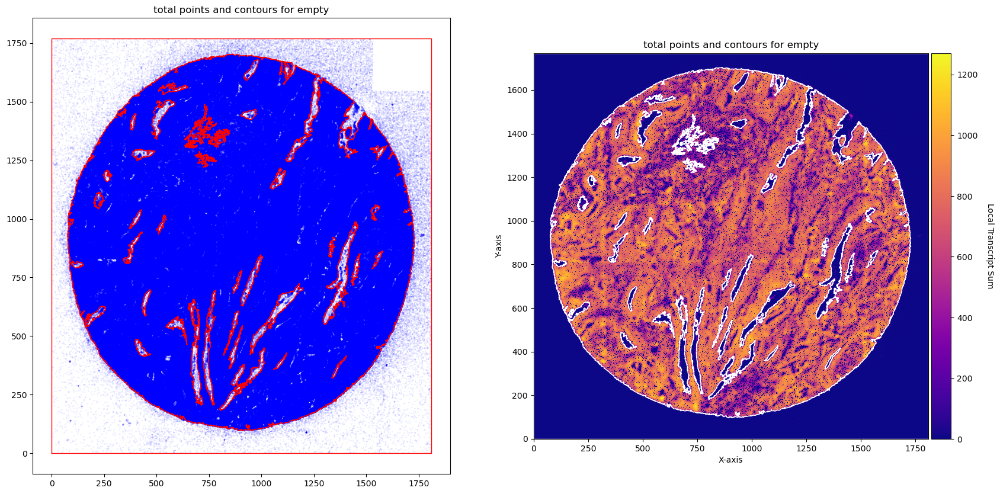

In [8]:
density_th_empty = 100
min_area_th_empty = 700
CEmpty.contours_from_neighbors(density_threshold = density_th_empty,
                       min_area_threshold = min_area_th_empty, 
                               directionality = 'lower') # attention that directionality is lower here 

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

CEmpty.plot_contours_scatter(path=None, show=False, s=0.05, alpha=0.5, linewidth=1,
                           c_points= 'blue',c_contours= 'red', ax=axs[0])
axs[0].set_title('total points and contours for empty')  
CEmpty.plot_conv_sum(cmap='plasma', c_countour='white', ax=axs[1])
axs[1].set_title('total points and contours for empty')

plt.show()
    

Define cancer the same way

2025-06-18 14:48:40,352 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:48:43,810 - gridgen.contours.cancer - INFO - get_kdt_dist took 3.4577 seconds
2025-06-18 14:48:43,819 - gridgen.contours.cancer - INFO - get_neighbour_array took 0.0082 seconds


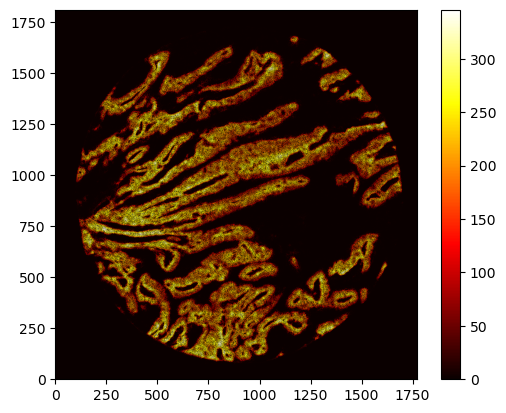

In [9]:
subset_condition = df_total['target'].isin(target_tum) 
df_subset = df_total[subset_condition]

Ctum = contours.KDTreeContours(df_subset[['target', 'X', 'Y']],
                               contour_name='cancer',
                               height=height, width=width)

Ctum.get_kdt_dist(radius = 10) # max distance of 10 
array_tum_nei = Ctum.get_neighbour_array() # array 2D of the neighboors per point

plt.imshow(array_tum_nei, cmap="hot", origin="lower")
plt.colorbar()
plt.show()

Because we are using a smaller set of targets, the points get sparse and makes difficult to derive contours. 

We can interpolate the array and derive the contours .

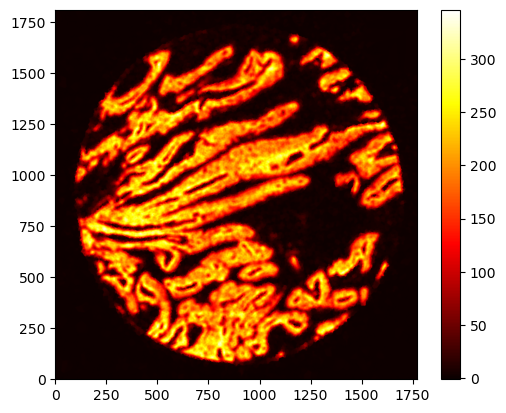

In [10]:
array_tum_nei = Ctum.interpolate_array()

plt.imshow(array_tum_nei, cmap="hot", origin="lower")
plt.colorbar()
plt.show()

2025-06-18 14:48:46,011 - gridgen.contours.cancer - INFO - Number of contours after filtering no counts: 35
2025-06-18 14:48:46,011 - gridgen.contours.cancer - INFO - Contours extracted from neighboor counts after checks: 35
2025-06-18 14:48:46,012 - gridgen.contours.cancer - INFO - contours_from_neighbors took 0.0227 seconds


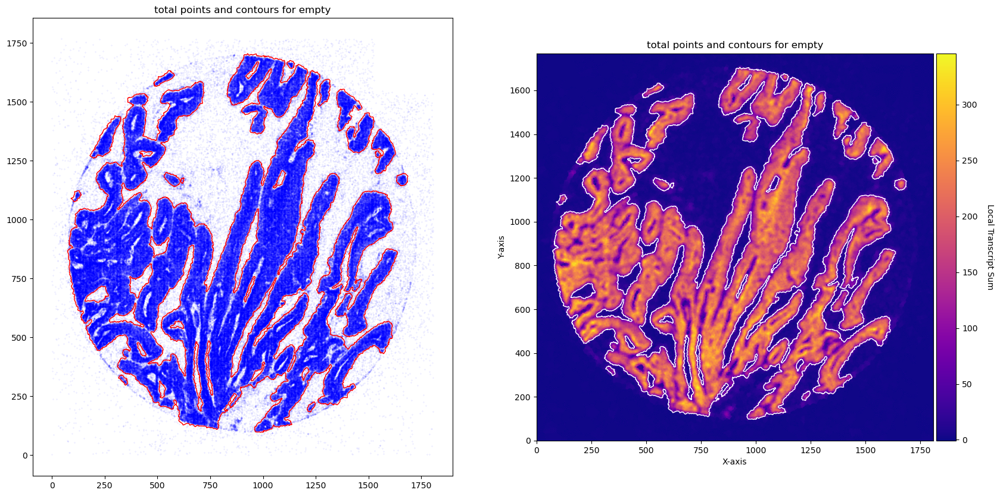

In [11]:
density_th_tum = 50
min_area_th_tum = 700
Ctum.contours_from_neighbors(density_threshold = density_th_tum,
                       min_area_threshold = min_area_th_tum,
                             directionality = 'higher') 

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

Ctum.plot_contours_scatter(path=None, show=False, s=0.05, alpha=0.5, linewidth=1,
                           c_points= 'blue',c_contours= 'red', ax=axs[0])
axs[0].set_title('total points and contours for empty')  
Ctum.plot_conv_sum(cmap='plasma', c_countour='white', ax=axs[1])
axs[1].set_title('total points and contours for empty')

plt.show()

With the contours, we can build the masks

2025-06-18 14:48:46,683 - gridgen.get_masks.GetMasks - INFO - Initialized GetMasks
2025-06-18 14:48:46,690 - gridgen.get_masks.GetMasks - INFO - Subtracted masks from base mask.


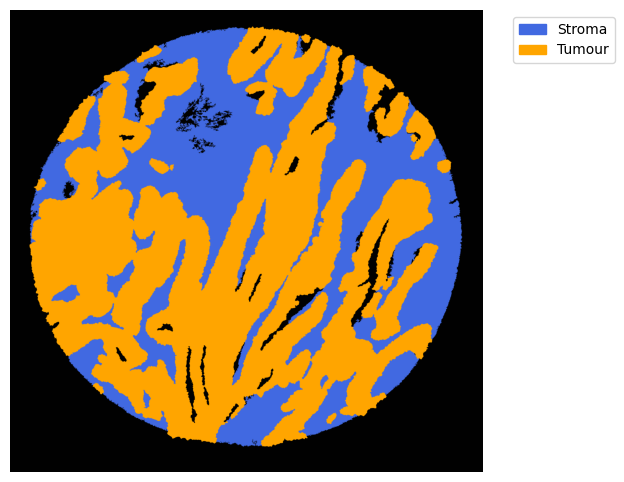

In [12]:
#### obtain masks
GM = get_masks.GetMasks(image_shape = (height, width))
  
mask_empty = GM.create_mask(CEmpty.contours)
mask_tum = GM.create_mask(Ctum.contours)
mask_stroma = GM.subtract_masks(np.ones((height, width), dtype=np.uint8), mask_tum, mask_empty)          
mask_stroma = GM.filter_binary_mask_by_area(mask_stroma, min_area=700)

GM.plot_masks(masks=[mask_stroma, mask_tum], mask_names=['Stroma', 'Tumour'],
                  background_color=(1, 1, 1), mask_colors={'Stroma': (65, 105, 225), 'Tumour': (255, 165, 0)},
                  path=None, show=True, ax=None, figsize=(8, 6))


Do full cohort

Processing Folders:   0%|                                                                                                                                | 0/20 [00:00<?, ?folder/s]2025-06-18 14:48:51,032 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:49:18,195 - gridgen.contours.empty - INFO - get_kdt_dist took 27.1587 seconds
2025-06-18 14:49:18,229 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0331 seconds
2025-06-18 14:49:18,794 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 57
2025-06-18 14:49:18,795 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 57
2025-06-18 14:49:18,806 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.5766 seconds
2025-06-18 14:49:18,946 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:49:21,413 - gridgen.contours.cancer - INFO - get_kdt_dist took 2.4657 seconds
2025-06-18 14:49:21,420 - gridgen.contours.cancer 

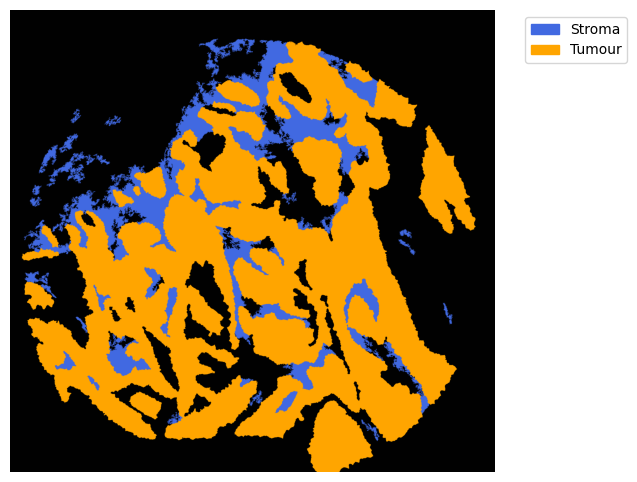

Processing Folders:   5%|██████                                                                                                                  | 1/20 [00:36<11:31, 36.39s/folder]2025-06-18 14:49:27,891 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:50:02,787 - gridgen.contours.empty - INFO - get_kdt_dist took 34.8923 seconds
2025-06-18 14:50:02,825 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0375 seconds
2025-06-18 14:50:03,308 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 49
2025-06-18 14:50:03,309 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 49
2025-06-18 14:50:03,317 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.4917 seconds
2025-06-18 14:50:03,476 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:50:05,036 - gridgen.contours.cancer - INFO - get_kdt_dist took 1.5580 seconds
2025-06-18 14:50:05,041 - gridgen.contours.cancer 

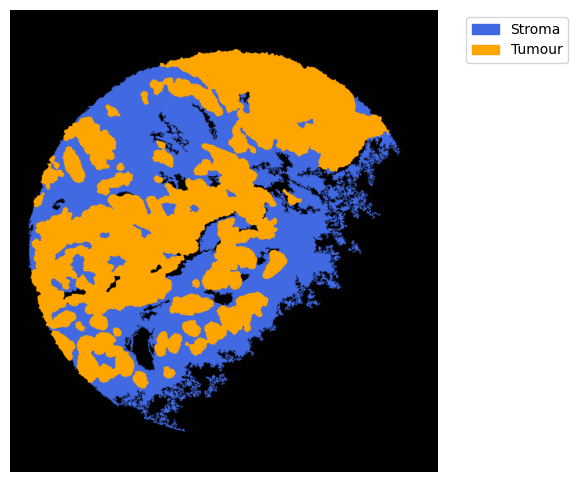

Processing Folders:  10%|████████████                                                                                                            | 2/20 [01:19<12:10, 40.60s/folder]2025-06-18 14:50:09,625 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:50:25,886 - gridgen.contours.empty - INFO - get_kdt_dist took 16.2566 seconds
2025-06-18 14:50:25,909 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0229 seconds
2025-06-18 14:50:26,644 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 217
2025-06-18 14:50:26,645 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 217
2025-06-18 14:50:26,657 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.7470 seconds
2025-06-18 14:50:26,754 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:50:27,139 - gridgen.contours.cancer - INFO - get_kdt_dist took 0.3839 seconds
2025-06-18 14:50:27,142 - gridgen.contours.cance

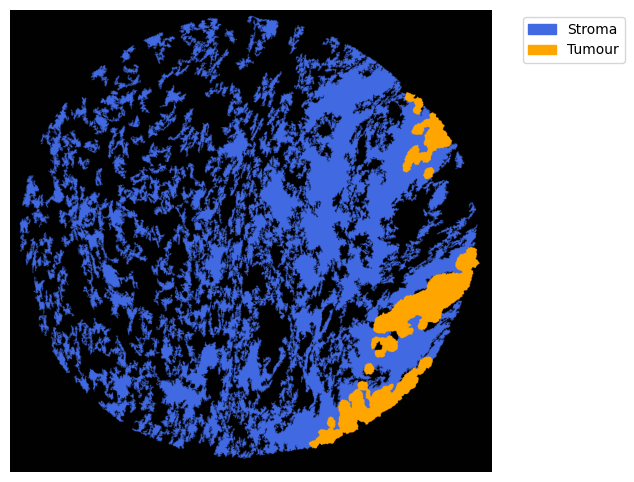

Processing Folders:  15%|██████████████████                                                                                                      | 3/20 [01:41<09:05, 32.06s/folder]2025-06-18 14:50:30,800 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:50:46,593 - gridgen.contours.empty - INFO - get_kdt_dist took 15.7895 seconds
2025-06-18 14:50:46,610 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0172 seconds
2025-06-18 14:50:46,773 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 20
2025-06-18 14:50:46,773 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 20
2025-06-18 14:50:46,777 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.1659 seconds
2025-06-18 14:50:46,851 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:50:47,458 - gridgen.contours.cancer - INFO - get_kdt_dist took 0.6071 seconds
2025-06-18 14:50:47,461 - gridgen.contours.cancer 

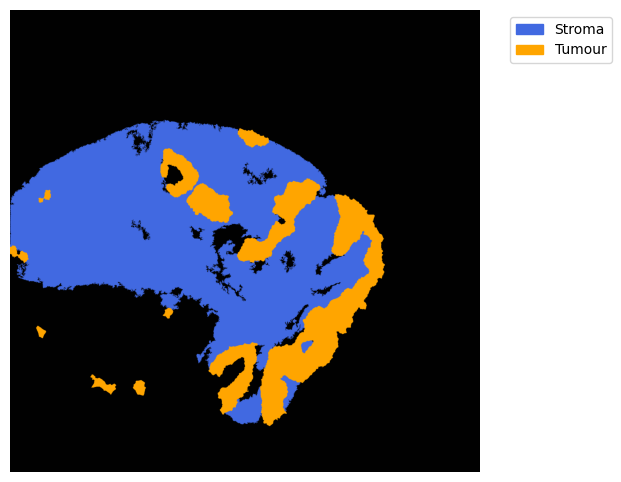

Processing Folders:  20%|████████████████████████                                                                                                | 4/20 [02:01<07:16, 27.30s/folder]2025-06-18 14:50:51,832 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:51:13,253 - gridgen.contours.empty - INFO - get_kdt_dist took 21.4182 seconds
2025-06-18 14:51:13,279 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0260 seconds
2025-06-18 14:51:14,055 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 123
2025-06-18 14:51:14,056 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 123
2025-06-18 14:51:14,068 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.7888 seconds
2025-06-18 14:51:14,173 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:51:14,744 - gridgen.contours.cancer - INFO - get_kdt_dist took 0.5707 seconds
2025-06-18 14:51:14,747 - gridgen.contours.cance

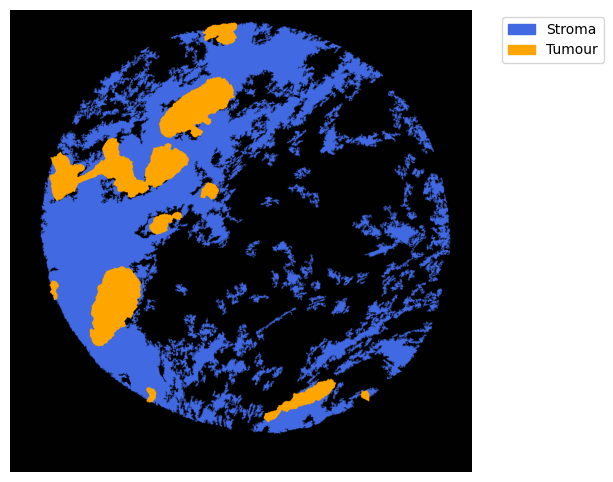

Processing Folders:  25%|██████████████████████████████                                                                                          | 5/20 [02:29<06:51, 27.46s/folder]2025-06-18 14:51:22,638 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:52:17,210 - gridgen.contours.empty - INFO - get_kdt_dist took 54.5686 seconds
2025-06-18 14:52:17,261 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0497 seconds
2025-06-18 14:52:17,646 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 19
2025-06-18 14:52:17,647 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 19
2025-06-18 14:52:17,656 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.3948 seconds
2025-06-18 14:52:17,871 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:52:19,524 - gridgen.contours.cancer - INFO - get_kdt_dist took 1.6526 seconds
2025-06-18 14:52:19,530 - gridgen.contours.cancer 

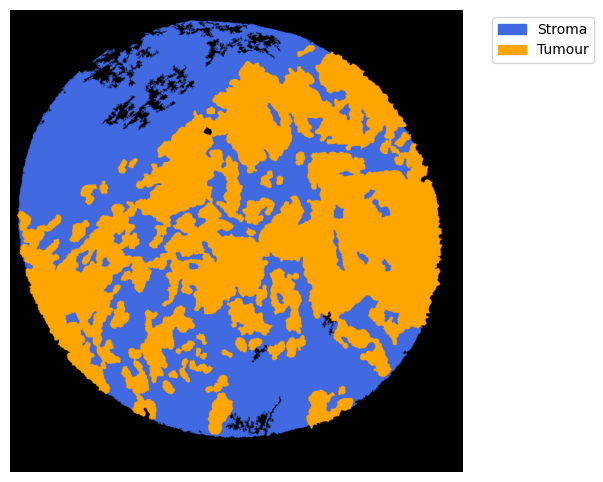

Processing Folders:  30%|████████████████████████████████████                                                                                    | 6/20 [03:34<09:22, 40.19s/folder]2025-06-18 14:52:26,550 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:53:07,380 - gridgen.contours.empty - INFO - get_kdt_dist took 40.6816 seconds
2025-06-18 14:53:07,423 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0418 seconds
2025-06-18 14:53:07,725 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 11
2025-06-18 14:53:07,725 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 11
2025-06-18 14:53:07,733 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.3094 seconds
2025-06-18 14:53:07,926 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:53:11,074 - gridgen.contours.cancer - INFO - get_kdt_dist took 3.1464 seconds
2025-06-18 14:53:11,082 - gridgen.contours.cancer 

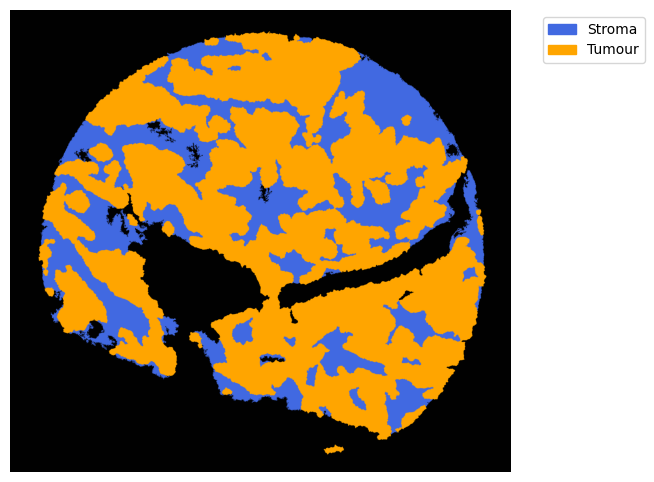

Processing Folders:  35%|██████████████████████████████████████████                                                                              | 7/20 [04:26<09:30, 43.90s/folder]2025-06-18 14:53:17,924 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:54:01,922 - gridgen.contours.empty - INFO - get_kdt_dist took 43.9770 seconds
2025-06-18 14:54:01,966 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0436 seconds
2025-06-18 14:54:02,294 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 42
2025-06-18 14:54:02,295 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 42
2025-06-18 14:54:02,302 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.3353 seconds
2025-06-18 14:54:02,487 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:54:05,924 - gridgen.contours.cancer - INFO - get_kdt_dist took 3.4354 seconds
2025-06-18 14:54:05,933 - gridgen.contours.cancer 

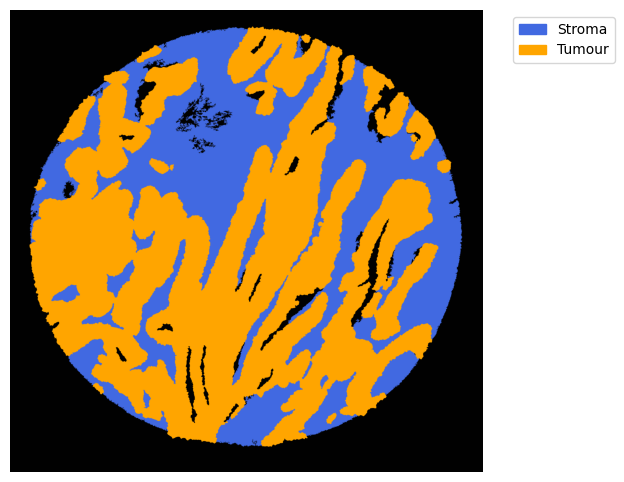

Processing Folders:  40%|████████████████████████████████████████████████                                                                        | 8/20 [05:20<09:27, 47.33s/folder]2025-06-18 14:54:12,087 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:54:43,993 - gridgen.contours.empty - INFO - get_kdt_dist took 31.8657 seconds
2025-06-18 14:54:44,033 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0385 seconds
2025-06-18 14:54:44,540 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 57
2025-06-18 14:54:44,541 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 57
2025-06-18 14:54:44,552 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.5186 seconds
2025-06-18 14:54:44,717 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:54:49,102 - gridgen.contours.cancer - INFO - get_kdt_dist took 4.3843 seconds
2025-06-18 14:54:49,112 - gridgen.contours.cancer 

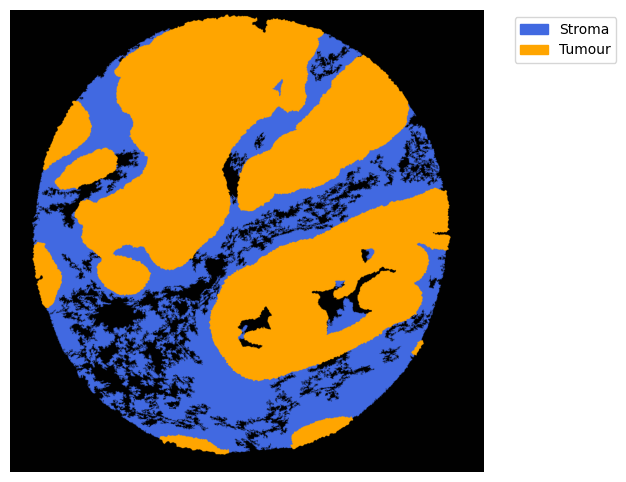

Processing Folders:  45%|██████████████████████████████████████████████████████                                                                  | 9/20 [06:03<08:26, 46.04s/folder]2025-06-18 14:54:53,264 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:55:07,798 - gridgen.contours.empty - INFO - get_kdt_dist took 14.5301 seconds
2025-06-18 14:55:07,821 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0218 seconds
2025-06-18 14:55:08,680 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 167
2025-06-18 14:55:08,681 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 167
2025-06-18 14:55:08,694 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.8733 seconds
2025-06-18 14:55:08,758 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:55:09,407 - gridgen.contours.cancer - INFO - get_kdt_dist took 0.6475 seconds
2025-06-18 14:55:09,410 - gridgen.contours.cance

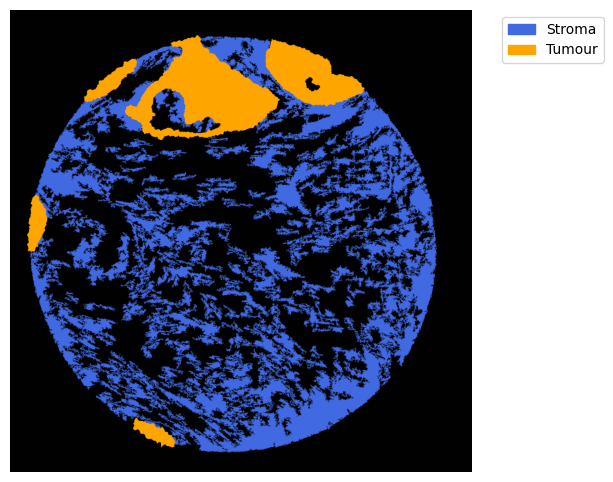

Processing Folders:  50%|███████████████████████████████████████████████████████████▌                                                           | 10/20 [06:24<06:21, 38.13s/folder]2025-06-18 14:55:14,543 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:55:35,929 - gridgen.contours.empty - INFO - get_kdt_dist took 21.3828 seconds
2025-06-18 14:55:35,958 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0278 seconds
2025-06-18 14:55:36,383 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 61
2025-06-18 14:55:36,383 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 61
2025-06-18 14:55:36,392 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.4334 seconds
2025-06-18 14:55:36,515 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:55:37,095 - gridgen.contours.cancer - INFO - get_kdt_dist took 0.5792 seconds
2025-06-18 14:55:37,098 - gridgen.contours.cancer 

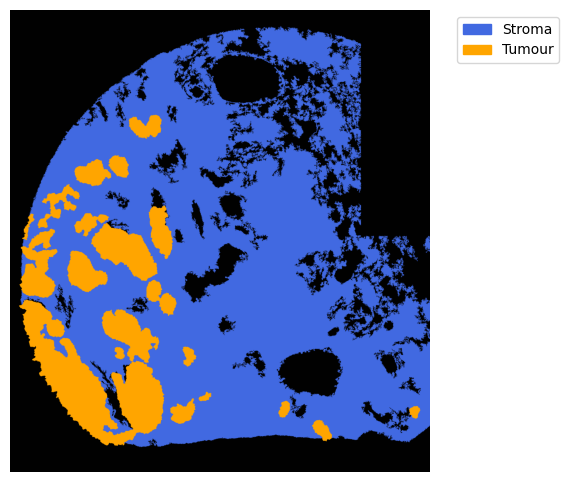

Processing Folders:  55%|█████████████████████████████████████████████████████████████████▍                                                     | 11/20 [06:51<05:12, 34.77s/folder]2025-06-18 14:55:42,486 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:56:14,776 - gridgen.contours.empty - INFO - get_kdt_dist took 32.2867 seconds
2025-06-18 14:56:14,811 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0344 seconds
2025-06-18 14:56:15,086 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 39
2025-06-18 14:56:15,087 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 39
2025-06-18 14:56:15,094 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.2821 seconds
2025-06-18 14:56:15,243 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:56:18,173 - gridgen.contours.cancer - INFO - get_kdt_dist took 2.9287 seconds
2025-06-18 14:56:18,180 - gridgen.contours.cancer 

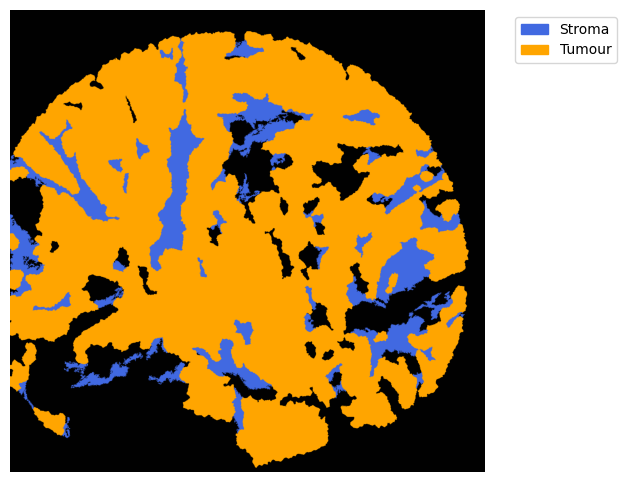

Processing Folders:  60%|███████████████████████████████████████████████████████████████████████▍                                               | 12/20 [07:32<04:53, 36.67s/folder]2025-06-18 14:56:22,891 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:56:44,031 - gridgen.contours.empty - INFO - get_kdt_dist took 21.1362 seconds
2025-06-18 14:56:44,061 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0289 seconds
2025-06-18 14:56:44,690 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 111
2025-06-18 14:56:44,691 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 111
2025-06-18 14:56:44,703 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.6414 seconds
2025-06-18 14:56:44,829 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:56:45,189 - gridgen.contours.cancer - INFO - get_kdt_dist took 0.3586 seconds
2025-06-18 14:56:45,192 - gridgen.contours.cance

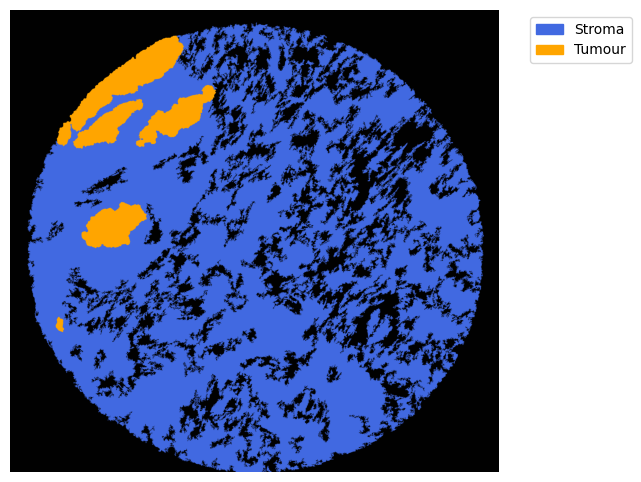

Processing Folders:  65%|█████████████████████████████████████████████████████████████████████████████▎                                         | 13/20 [07:59<03:56, 33.80s/folder]2025-06-18 14:56:49,127 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:57:04,575 - gridgen.contours.empty - INFO - get_kdt_dist took 15.4449 seconds
2025-06-18 14:57:04,597 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0211 seconds
2025-06-18 14:57:05,141 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 89
2025-06-18 14:57:05,142 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 89
2025-06-18 14:57:05,152 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.5545 seconds
2025-06-18 14:57:05,243 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:57:06,602 - gridgen.contours.cancer - INFO - get_kdt_dist took 1.3583 seconds
2025-06-18 14:57:06,608 - gridgen.contours.cancer 

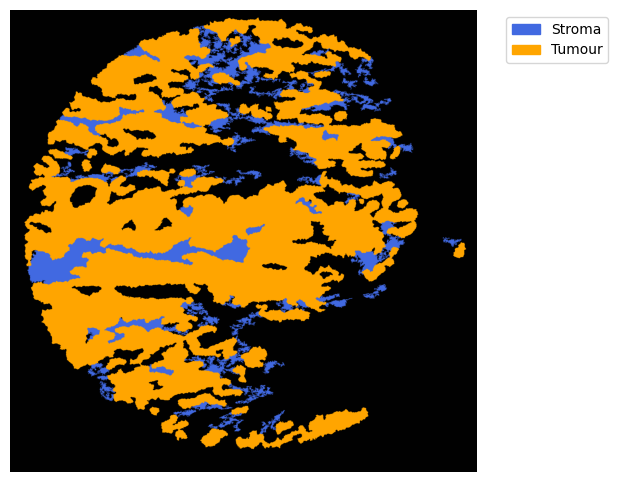

Processing Folders:  70%|███████████████████████████████████████████████████████████████████████████████████▎                                   | 14/20 [08:21<03:00, 30.11s/folder]2025-06-18 14:57:13,100 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:57:53,138 - gridgen.contours.empty - INFO - get_kdt_dist took 40.0348 seconds
2025-06-18 14:57:53,178 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0401 seconds
2025-06-18 14:57:53,502 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 39
2025-06-18 14:57:53,503 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 39
2025-06-18 14:57:53,510 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.3316 seconds
2025-06-18 14:57:53,693 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:57:57,776 - gridgen.contours.cancer - INFO - get_kdt_dist took 4.0821 seconds
2025-06-18 14:57:57,785 - gridgen.contours.cancer 

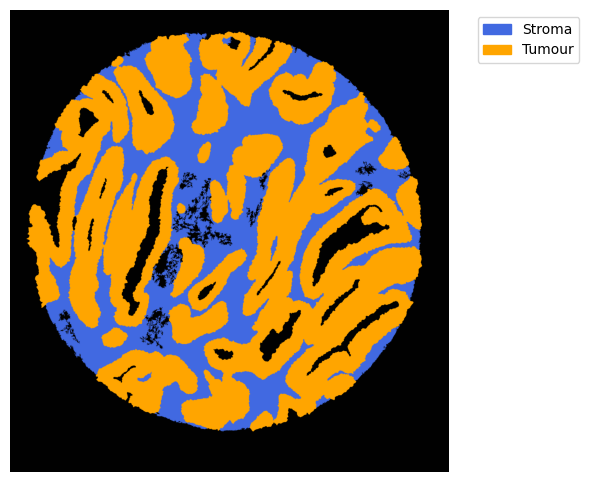

Processing Folders:  75%|█████████████████████████████████████████████████████████████████████████████████████████▎                             | 15/20 [09:12<03:02, 36.49s/folder]2025-06-18 14:58:04,376 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:58:44,278 - gridgen.contours.empty - INFO - get_kdt_dist took 39.8965 seconds
2025-06-18 14:58:44,318 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0394 seconds
2025-06-18 14:58:44,644 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 41
2025-06-18 14:58:44,644 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 41
2025-06-18 14:58:44,652 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.3331 seconds
2025-06-18 14:58:44,824 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:58:47,233 - gridgen.contours.cancer - INFO - get_kdt_dist took 2.4079 seconds
2025-06-18 14:58:47,239 - gridgen.contours.cancer 

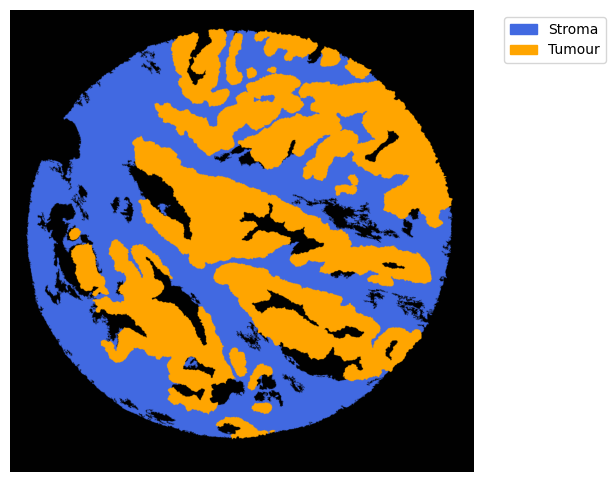

Processing Folders:  80%|███████████████████████████████████████████████████████████████████████████████████████████████▏                       | 16/20 [10:01<02:41, 40.36s/folder]2025-06-18 14:58:52,328 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:59:14,345 - gridgen.contours.empty - INFO - get_kdt_dist took 22.0118 seconds
2025-06-18 14:59:14,374 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0284 seconds
2025-06-18 14:59:14,963 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 93
2025-06-18 14:59:14,964 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 93
2025-06-18 14:59:14,975 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.6003 seconds
2025-06-18 14:59:15,103 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:59:16,219 - gridgen.contours.cancer - INFO - get_kdt_dist took 1.1147 seconds
2025-06-18 14:59:16,223 - gridgen.contours.cancer 

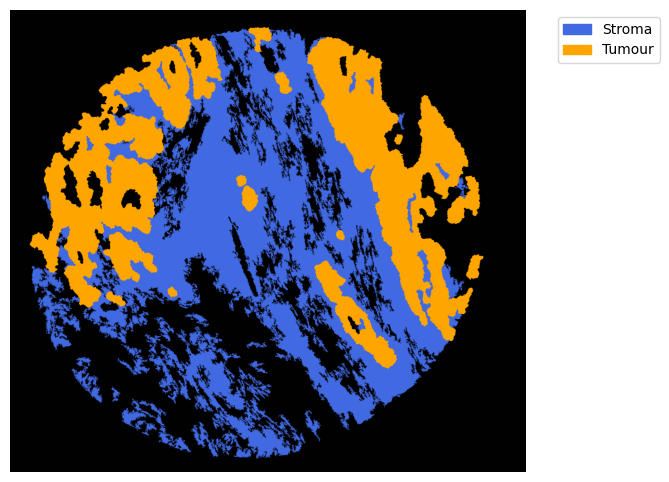

Processing Folders:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 17/20 [10:31<01:51, 37.01s/folder]2025-06-18 14:59:21,848 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 14:59:49,271 - gridgen.contours.empty - INFO - get_kdt_dist took 27.4191 seconds
2025-06-18 14:59:49,304 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0322 seconds
2025-06-18 14:59:49,691 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 42
2025-06-18 14:59:49,692 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 42
2025-06-18 14:59:49,700 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.3950 seconds
2025-06-18 14:59:49,839 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 14:59:52,088 - gridgen.contours.cancer - INFO - get_kdt_dist took 2.2480 seconds
2025-06-18 14:59:52,095 - gridgen.contours.cancer 

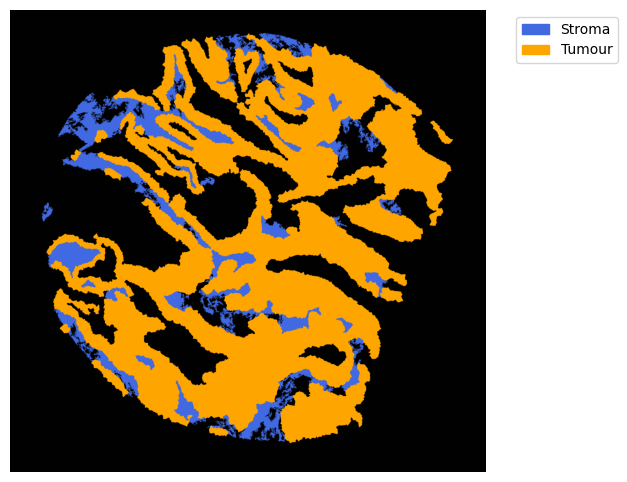

Processing Folders:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████            | 18/20 [11:07<01:13, 36.74s/folder]/tmp/ipykernel_4069310/2892387316.py:15: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  df_total = pd.read_csv(file_csv)
2025-06-18 14:59:57,466 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 15:00:17,691 - gridgen.contours.empty - INFO - get_kdt_dist took 20.2213 seconds
2025-06-18 15:00:17,719 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0274 seconds
2025-06-18 15:00:18,233 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 73
2025-06-18 15:00:18,234 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 73
2025-06-18 15:00:18,243 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.5239 seconds
2025-06-18 15:00:18,358 - gridgen.contours.canc

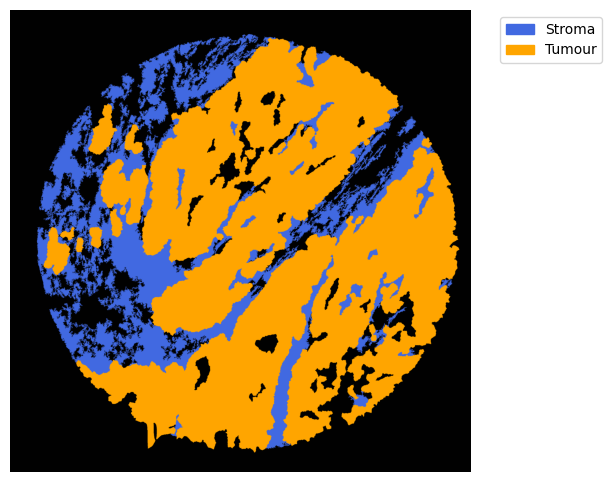

Processing Folders:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 19/20 [11:35<00:34, 34.09s/folder]2025-06-18 15:00:25,110 - gridgen.contours.empty - INFO - Initialized GetContour
2025-06-18 15:00:44,082 - gridgen.contours.empty - INFO - get_kdt_dist took 18.9689 seconds
2025-06-18 15:00:44,110 - gridgen.contours.empty - INFO - get_neighbour_array took 0.0263 seconds
2025-06-18 15:00:44,621 - gridgen.contours.empty - INFO - Number of contours after filtering no counts: 84
2025-06-18 15:00:44,621 - gridgen.contours.empty - INFO - Contours extracted from neighboor counts after checks: 84
2025-06-18 15:00:44,631 - gridgen.contours.empty - INFO - contours_from_neighbors took 0.5206 seconds
2025-06-18 15:00:44,747 - gridgen.contours.cancer - INFO - Initialized GetContour
2025-06-18 15:00:46,993 - gridgen.contours.cancer - INFO - get_kdt_dist took 2.2454 seconds
2025-06-18 15:00:47,000 - gridgen.contours.cancer 

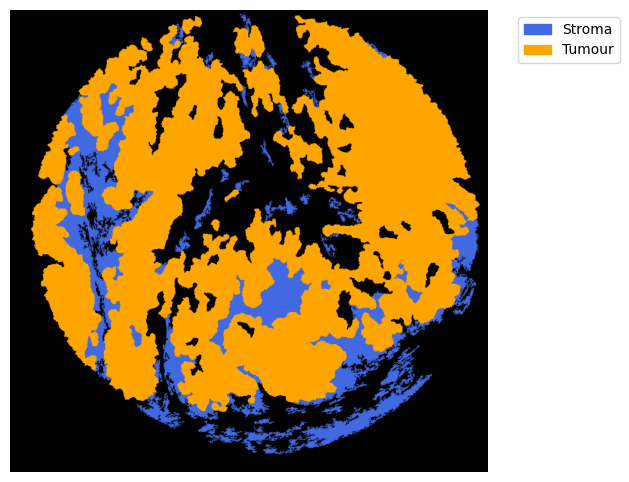

Processing Folders: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [12:01<00:00, 36.08s/folder]


In [13]:
radius = max_dist = 10  # 100 px 
density_th_empty = 100
min_area_th_empty = 700
density_th_tum = 50
min_area_th_tum = 700

for file_csv in tqdm(files, desc="Processing Folders", unit="folder"):
    start_time = time.time()
    filename = os.path.basename(file_csv).split('.')[0] # Extract the filename without extension
    name_file = '_'.join(filename.split('_')[:2])# Extract the desired part
    path_save = f"results/kdtree/{name_file}/"
    if not os.path.exists(path_save):
        os.makedirs(path_save)
        
    df_total = pd.read_csv(file_csv)

    df_total = df_total[['x_location', 'y_location', 'feature_name']]
    df_total = df_total.rename(columns={'feature_name': 'target'})
    df_total = df_total[~df_total['target'].str.contains('System|egative')]
    df_total['X'] = df_total['x_location'] - min(df_total['x_location'])
    df_total['Y'] = df_total['y_location'] - min(df_total['y_location'])
    
    n_genes = len(df_total['target'].unique())
    height = int(max(df_total['X'])) + 1
    width = int(max(df_total['Y'])) + 1
    
    
    CEmpty = contours.KDTreeContours(df_total[['target', 'X', 'Y']], contour_name='empty', 
                                height=height, width=width)

    CEmpty.get_kdt_dist(radius = 10) # max distance of 10 
    array_total_nei = CEmpty.get_neighbour_array() # array 2D of the neighboors per point
    CEmpty.contours_from_neighbors(density_threshold = density_th_empty,
                           min_area_threshold = min_area_th_empty, 
                                   directionality = 'lower') # attention that directionality is lower here 
    
    subset_condition = df_total['target'].isin(target_tum) 
    df_subset = df_total[subset_condition]

    Ctum = contours.KDTreeContours(df_subset[['target', 'X', 'Y']],
                                   contour_name='cancer',
                                   height=height, width=width)

    Ctum.get_kdt_dist(radius = 10) # max distance of 10 
    array_tum_nei = Ctum.get_neighbour_array() # array 2D of the neighboors per point
    array_tum_nei = Ctum.interpolate_array()
    Ctum.contours_from_neighbors(density_threshold = density_th_tum,
                           min_area_threshold = min_area_th_tum,
                                 directionality = 'higher') 

    #### obtain masks
    GM = get_masks.GetMasks(image_shape = (height, width))
  
    mask_empty = GM.create_mask(CEmpty.contours)
    mask_tum = GM.create_mask(Ctum.contours)
    mask_stroma = GM.subtract_masks(np.ones((height, width), dtype=np.uint8), mask_tum, mask_empty)          
    mask_stroma = GM.filter_binary_mask_by_area(mask_stroma, min_area=700)

    GM.plot_masks(masks=[mask_stroma, mask_tum], mask_names=['Stroma', 'Tumour'],
                      background_color=(1, 1, 1), mask_colors={'Stroma': (65, 105, 225), 'Tumour': (255, 165, 0)},
                      path=None, show=True, ax=None, figsize=(8, 6))

***KDTree approach to identify γδ enriched regions***

We also applied the KD-tree method to identify spatial associations between TRGC and TRDC transcripts in order to identify γδ T cell regions. Specifically, we searched for transcript pairs located within a 7 μm radius. Due to the sparsity of these transcripts and the lack of sufficient density for contour generation, we defined regions by drawing circular masks centered on the identified transcript. 

CosMx

In [3]:
cosmx_path_s3 =  '../../cosmx_data/S3/S3/20230628_151317_S3/AnalysisResults/yxyz3r7ufm'
dapi_folder = '/home/martinha/PycharmProjects/phd/spatial_transcriptomics/cosmx_data/S3/S3/20230628_151317_S3/CellStatsDir/Morphology2D/'
folder_names_s3 = [folder_name for folder_name in os.listdir(cosmx_path_s3) if
                os.path.isdir(os.path.join(cosmx_path_s3, folder_name))]


target_files_s3 = [
    os.path.join(cosmx_path_s3, folder, file)
    for folder in os.listdir(cosmx_path_s3)
    if os.path.isdir(os.path.join(cosmx_path_s3, folder))
    for file in os.listdir(os.path.join(cosmx_path_s3, folder))
    if '__target_call_coord.csv' in file
]

files_cosmx = natsorted(target_files_s3)
len(files_cosmx)

20

In [4]:
target_gd = ['TRGC1/TRGC2', 'TRDC']
target_ab = ['TRBC1/TRBC2', 'TRAC']
target_tum = ['EPCAM', 'SMIM22','CLDN3', 'KRT18','LGALS4', 'KRT8', 'ELF3','TSPAN8', 'STMN1', 'CD47', 'MYC', 'LGALS3'] 


target_cd8 = ['CD8A','CD8B', 'TRBC1/TRBC2', 'TRAC']
target_cd4 = ['CD4']


In [16]:
fov = 'FOV007'
file_csv = [file for file in files_cosmx if fov in file][0]  
    
df_total = pd.read_csv(file_csv)
df_total = df_total.rename(columns={'x': 'X', 'y': 'Y'})
df_total = df_total[~df_total['target'].str.contains('System|egative')]

n_genes = len(df_total['target'].unique())
height = int(max(df_total['X'])) + 1
width = int(max(df_total['Y'])) + 1

print(f'n genes: {n_genes}')
print(f'shape: {height}, {width}')
print(f'n hits {len(df_total)}')

n genes: 999
shape: 4246, 4245
n hits 2838781


In [17]:
# this makes the sparse df to an array with the spatial information 
target_dict_total = {target: index for index, target in enumerate(df_total['target'].unique())}
array_total = ga.transform_df_to_array(df = df_total, target_dict=target_dict_total, array_shape = (height, width,len(target_dict_total))).astype(np.int8)

# creating subsets 
df_subset_gd, array_subset_gd, target_indices_subset_gd = ga.get_subset_arrays(df_total, array_total,
                                                                                   target_dict_total,
                                                                                   target_list=target_gd,
                                                                           target_col='target')

df_subset_ab, array_subset_ab, target_indices_subset_ab = ga.get_subset_arrays(df_total, array_total,
                                                                                       target_dict_total,
                                                                                       target_list=target_ab,
                                                                                       target_col='target')
    
    
df_subset_g, array_subset_g, target_indices_subset_g = ga.get_subset_arrays(df_total, array_total,
                                                                                       target_dict_total,
                                                                                       target_list=['TRGC1/TRGC2'],
                                                                                       target_col='target')
    
df_subset_d, array_subset_d, target_indices_subset_d = ga.get_subset_arrays(df_total, array_total,
                                                                                       target_dict_total,
                                                                                       target_list=['TRDC'],
                                                                                       target_col='target')


T cells are usually between 5-10 um diameter, in CosMx this will be between 21px and 43 px. 
Use KDtrees to find points of TRDC and TRGC that dist less than 43px between each other. 
We will find all points that have at least 1 neighbouring point in a  radius of 43 px. 
The points that are closed together are then enclosed in a simple circle contour. 

The fact that 2 points of TRDC or TRGC are closed together does not mean that we are in the presence of a GD area. We will filter the contours and only consider the ones where there are at least 1 TRDC and 1 TRGC and the sum of counts of TRGC and TRDC are higher than TRAC and TRBC. 

As the points for GD are very sparse we take a different approach here. 

Instead of counting neighboor points and select contours around it, we will query and find all the points in a 25 radius that have at least one neighboor. We will use it to draw contours around the points as simple circles. 

The filtering follows the same strategy as before

2025-06-18 15:01:00,211 - gridgen.contours.gd - INFO - Initialized GetContour
2025-06-18 15:01:00,221 - gridgen.contours.gd - INFO - Points with more than 1 neighbors: 614
2025-06-18 15:01:00,231 - gridgen.contours.gd - INFO - Points w/ neig agglomerated in DBSCAN labels: 614
2025-06-18 15:01:01,235 - gridgen.contours.gd - INFO - N contours: 242


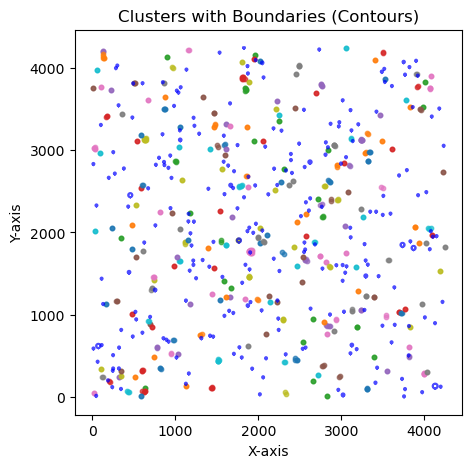

2025-06-18 15:01:04,721 - gridgen.contours.gd - INFO - Excluding contour 31. gd count 1.00 ≤ ab count 2.00
2025-06-18 15:01:07,784 - gridgen.contours.gd - INFO - Excluding contour 85. gd count 1.00 ≤ ab count 2.00
2025-06-18 15:01:09,477 - gridgen.contours.gd - INFO - Excluding contour 115. gd count 1.00 ≤ ab count 2.00
2025-06-18 15:01:10,560 - gridgen.contours.gd - INFO - Excluding contour 134. gd count 1.00 ≤ ab count 1.00
2025-06-18 15:01:10,901 - gridgen.contours.gd - INFO - Excluding contour 140. gd count 0.00 ≤ ab count 0.00
2025-06-18 15:01:11,402 - gridgen.contours.gd - INFO - Excluding contour 149. gd count 2.00 ≤ ab count 2.00
2025-06-18 15:01:14,632 - gridgen.contours.gd - INFO - Excluding contour 206. gd count 1.00 ≤ ab count 1.00
2025-06-18 15:01:14,920 - gridgen.contours.gd - INFO - Excluding contour 211. gd count 1.00 ≤ ab count 1.00
2025-06-18 15:01:16,629 - gridgen.contours.gd - INFO - Contours remaining after gene comparison: 234
2025-06-18 15:01:16,685 - gridgen.con

2025-06-18 15:01:21,510 - gridgen.contours.gd - INFO - Excluding contour 173. Gene TRDC count  0.0 is below threshold 1
2025-06-18 15:01:21,539 - gridgen.contours.gd - INFO - Excluding contour 174. Gene TRDC count  0.0 is below threshold 1
2025-06-18 15:01:21,595 - gridgen.contours.gd - INFO - Excluding contour 176. Gene TRDC count  0.0 is below threshold 1
2025-06-18 15:01:21,624 - gridgen.contours.gd - INFO - Excluding contour 177. Gene TRDC count  0.0 is below threshold 1
2025-06-18 15:01:21,681 - gridgen.contours.gd - INFO - Excluding contour 179. Gene TRDC count  0.0 is below threshold 1
2025-06-18 15:01:21,765 - gridgen.contours.gd - INFO - Excluding contour 182. Gene TRDC count  0.0 is below threshold 1
2025-06-18 15:01:21,794 - gridgen.contours.gd - INFO - Excluding contour 183. Gene TRDC count  0.0 is below threshold 1
2025-06-18 15:01:21,851 - gridgen.contours.gd - INFO - Excluding contour 185. Gene TRDC count  0.0 is below threshold 1
2025-06-18 15:01:21,907 - gridgen.contou

2025-06-18 15:01:24,652 - gridgen.contours.gd - INFO - Excluding contour 49. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:24,681 - gridgen.contours.gd - INFO - Excluding contour 50. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:24,710 - gridgen.contours.gd - INFO - Excluding contour 51. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:24,739 - gridgen.contours.gd - INFO - Excluding contour 52. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:24,767 - gridgen.contours.gd - INFO - Excluding contour 53. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:24,796 - gridgen.contours.gd - INFO - Excluding contour 54. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:24,826 - gridgen.contours.gd - INFO - Excluding contour 55. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:24,856 - gridgen.contours.gd - INFO - Excluding contour 56. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:24,885 

2025-06-18 15:01:26,829 - gridgen.contours.gd - INFO - Excluding contour 125. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:26,857 - gridgen.contours.gd - INFO - Excluding contour 126. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:26,885 - gridgen.contours.gd - INFO - Excluding contour 127. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:26,914 - gridgen.contours.gd - INFO - Excluding contour 128. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:26,942 - gridgen.contours.gd - INFO - Excluding contour 129. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:27,001 - gridgen.contours.gd - INFO - Excluding contour 131. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:27,031 - gridgen.contours.gd - INFO - Excluding contour 132. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01:27,060 - gridgen.contours.gd - INFO - Excluding contour 133. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 15:01

CPU times: user 33.1 s, sys: 20.1 ms, total: 33.2 s
Wall time: 27.1 s


In [18]:
%%time 

df_subset_gd = df_total[df_total['target'].isin(target_gd)]
CGD = contours.KDTreeContours(df_subset_gd, contour_name = 'gd', height=height, width = width)
CGD.find_points_with_neighoors(radius = 25, min_neighbours = 1)
CGD.get_contours_around_points_with_neighboors(type_contouring='simple_circle')

CGD.plot_point_clusters_with_contours(show=True, figsize=(5, 5))


# ### Filtering 
CGD.filter_contours_by_gene_comparison(gene_array1 = array_subset_gd, gene_array2 = array_subset_ab,
                                       gene_name1 = "gd", gene_name2 = "ab") # gene 1 > gene2 --> valid contour 
# G>0 D>0
CGD.filter_contours_by_gene_threshold(gene_array = array_subset_d.squeeze(), threshold = 1, gene_name = 'TRDC')# >= 1
CGD.filter_contours_by_gene_threshold(gene_array = np.sum(array_subset_g, axis=-1), threshold = 1, gene_name = 'TRGC1_2')# >= 1

    #### obtain masks

<Axes: title={'center': 'Scatter with contours and genes gd'}>

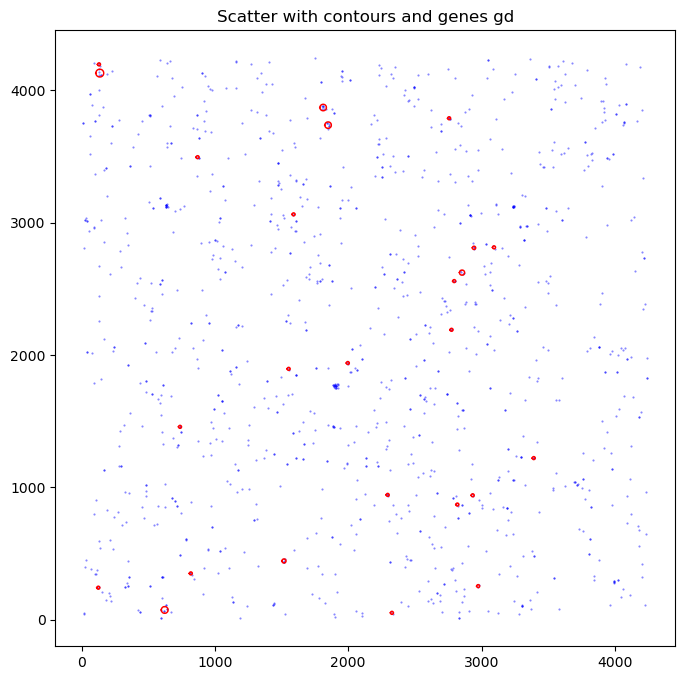

In [19]:
CGD.plot_contours_scatter(path=None, show=False, s=1, alpha=0.5, linewidth=1,
                           c_points= 'blue',c_contours= 'red',figsize=(8,8))

**Plot overlay with DAPI image**

Lets visualize with DAPI images and the trancripts



In [20]:
dapi_file = [file for file in os.listdir(dapi_folder) if str(fov[3:]) in file][0]
dapi_file_path = os.path.join(dapi_folder, dapi_file)

cell_counts = f"../../cosmx_data/S3/S3/20230628_151317_S3/AnalysisResults/yxyz3r7ufm/{fov}/Run_69de8227-1a7b-40ee-ba46-0ea99a7c59f4_{fov}__complete_code_cell_target_call_coord.csv"
cell_counts_df = pd.read_csv(cell_counts)
target_list = ['TRGC1/TRGC2', 'TRDC','TRBC1/TRBC2', 'TRAC']
filtered_data = cell_counts_df[cell_counts_df['target'].isin(target_list)]
print(filtered_data['target'].value_counts())

img_gd_contour = plot_TRGC_TRDC_points_contours(CGD.contours, filtered_data, dapi_file_path)

target
TRBC1/TRBC2    1598
TRAC            886
TRDC            706
TRGC1/TRGC2     537
Name: count, dtype: int64
<built-in method max of numpy.ndarray object at 0x7facba371bf0>


build the masks and obtain the centroids to plot zoom in sections

In [22]:
GM = get_masks.GetMasks(image_shape=(height, width))

SA = get_masks.SingleClassObjectAnalysis(GM, contours_object=CGD.contours)
SA.get_mask_objects(exclude_masks=None)  # Not excluding any tum or empty 

mask_GD = SA.mask_object_SA

morpho_properties= MorphologyExtractor().extract_per_object_features(labeled_mask= label(mask_GD))
centroids = [(obj['centroid_x'], obj['centroid_y']) for obj in morpho_properties]
centroids = [(float(y), float(x)) for (x, y) in centroids]

2025-06-18 15:11:40,280 - gridgen.get_masks.GetMasks - INFO - Initialized GetMasks
2025-06-18 15:11:40,282 - gridgen.get_masks.GetMasks - INFO - Mask for objects created.


Plot zoomed in 

In [6]:
def plot_zoom_boxes_on_image(
    img,
    centroids,
    box_size = 500,
    num_cols = 4,
    show_titles = True,
    draw_boxes = True
):
    half_box = box_size // 2
    img_w, img_h = img.size

    # Show original image with optional boxes
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(img)
    ax.set_title("Image with Boxes")
    ax.axis('off')

    zoom_coords = []

    for (cx, cy) in centroids:
        left = max(0, int(cx - half_box))
        upper = max(0, int(cy - half_box))
        right = min(left + box_size, img_w)
        lower = min(upper + box_size, img_h)

        # Adjust left and upper if right/lower were clamped
        left = max(0, right - box_size)
        upper = max(0, lower - box_size)

        zoom_coords.append((left, upper, right, lower))

        if draw_boxes:
            rect = patches.Rectangle(
                (left, upper), box_size, box_size,
                linewidth=2, edgecolor='red', facecolor='none', linestyle='dotted'
            )
            ax.add_patch(rect)

    plt.show()

    # Plot zoomed-in crops
    num_coords = len(zoom_coords)
    num_rows = (num_coords + num_cols - 1) // num_cols

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 5 * num_rows))

    # Normalize axes for different shapes
    axes = axes.flatten() if num_coords > 1 else [axes]

    for idx, (left, upper, right, lower) in enumerate(zoom_coords):
        ax = axes[idx]
        cropped_img = img.crop((left, upper, right, lower))
        ax.imshow(cropped_img, origin='lower')
        ax.axis('off')
        if show_titles:
            cx, cy = centroids[idx]
            ax.set_title(f"Zoom {idx + 1} ({cx:.1f}, {cy:.1f})")

    # Hide unused subplots
    for idx in range(num_coords, len(axes)):
        axes[idx].axis('off')

    plt.tight_layout()
    plt.show()
    

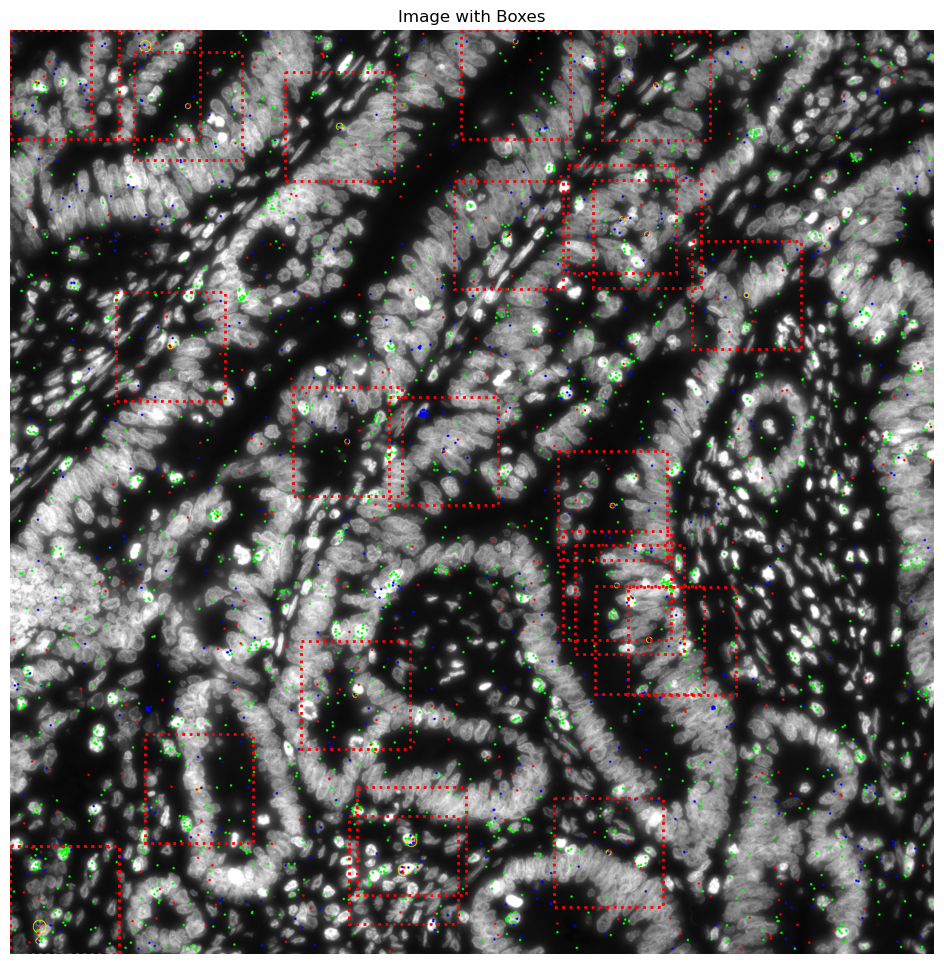

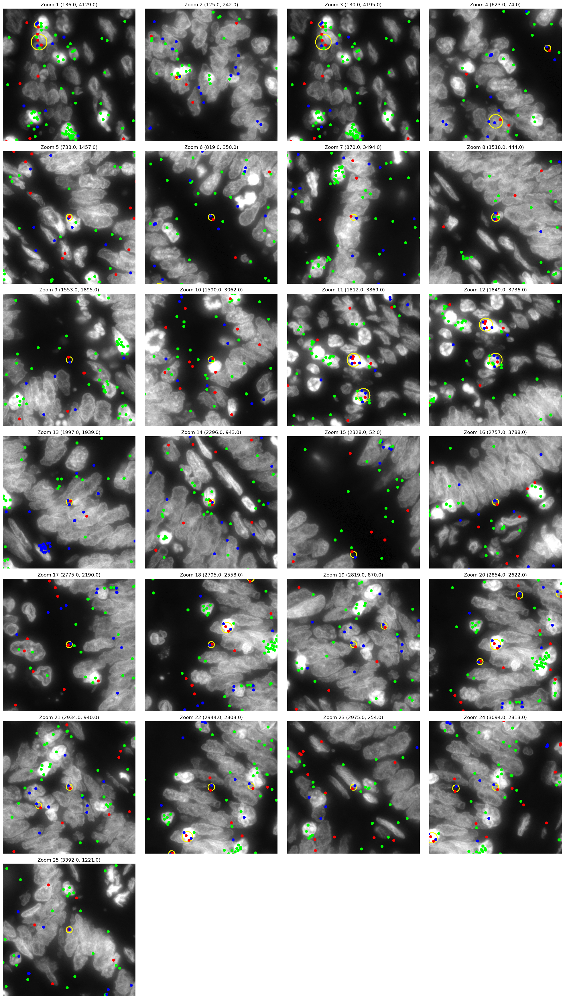

In [25]:
  plot_zoom_boxes_on_image(img_gd_contour, centroids, box_size = 500,num_cols = 4,
    show_titles = True, draw_boxes = True)


Check other FOV

2025-06-18 16:43:09,251 - gridgen.contours.gd - INFO - Initialized GetContour
2025-06-18 16:43:09,266 - gridgen.contours.gd - INFO - Points with more than 1 neighbors: 591
2025-06-18 16:43:09,268 - gridgen.contours.gd - INFO - Points w/ neig agglomerated in DBSCAN labels: 591
2025-06-18 16:43:10,321 - gridgen.contours.gd - INFO - N contours: 208
2025-06-18 16:43:11,444 - gridgen.contours.gd - INFO - Excluding contour 10. gd count 2.00 ≤ ab count 2.00
2025-06-18 16:43:11,910 - gridgen.contours.gd - INFO - Excluding contour 17. gd count 1.00 ≤ ab count 1.00
2025-06-18 16:43:14,609 - gridgen.contours.gd - INFO - Excluding contour 58. gd count 2.00 ≤ ab count 2.00
2025-06-18 16:43:16,517 - gridgen.contours.gd - INFO - Excluding contour 87. gd count 0.00 ≤ ab count 0.00
2025-06-18 16:43:16,970 - gridgen.contours.gd - INFO - Excluding contour 94. gd count 2.00 ≤ ab count 2.00
2025-06-18 16:43:17,106 - gridgen.contours.gd - INFO - Excluding contour 96. gd count 0.00 ≤ ab count 0.00
2025-06-18

2025-06-18 16:43:29,912 - gridgen.contours.gd - INFO - Excluding contour 160. Gene TRDC count  0.0 is below threshold 1
2025-06-18 16:43:29,947 - gridgen.contours.gd - INFO - Excluding contour 161. Gene TRDC count  0.0 is below threshold 1
2025-06-18 16:43:29,981 - gridgen.contours.gd - INFO - Excluding contour 162. Gene TRDC count  0.0 is below threshold 1
2025-06-18 16:43:30,085 - gridgen.contours.gd - INFO - Excluding contour 165. Gene TRDC count  0.0 is below threshold 1
2025-06-18 16:43:30,120 - gridgen.contours.gd - INFO - Excluding contour 166. Gene TRDC count  0.0 is below threshold 1
2025-06-18 16:43:30,156 - gridgen.contours.gd - INFO - Excluding contour 167. Gene TRDC count  0.0 is below threshold 1
2025-06-18 16:43:30,293 - gridgen.contours.gd - INFO - Excluding contour 171. Gene TRDC count  0.0 is below threshold 1
2025-06-18 16:43:30,327 - gridgen.contours.gd - INFO - Excluding contour 172. Gene TRDC count  0.0 is below threshold 1
2025-06-18 16:43:30,362 - gridgen.contou

2025-06-18 16:43:33,703 - gridgen.contours.gd - INFO - Excluding contour 74. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 16:43:33,771 - gridgen.contours.gd - INFO - Excluding contour 76. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 16:43:33,805 - gridgen.contours.gd - INFO - Excluding contour 77. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 16:43:33,840 - gridgen.contours.gd - INFO - Excluding contour 78. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 16:43:33,909 - gridgen.contours.gd - INFO - Excluding contour 80. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 16:43:33,944 - gridgen.contours.gd - INFO - Excluding contour 81. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 16:43:33,978 - gridgen.contours.gd - INFO - Excluding contour 82. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 16:43:34,047 - gridgen.contours.gd - INFO - Excluding contour 84. Gene TRGC1_2 count  0.0 is below threshold 1
2025-06-18 16:43:34,150 

target
TRBC1/TRBC2    2250
TRAC           1195
TRDC            740
TRGC1/TRGC2     546
Name: count, dtype: int64
<built-in method max of numpy.ndarray object at 0x7fac016f0090>


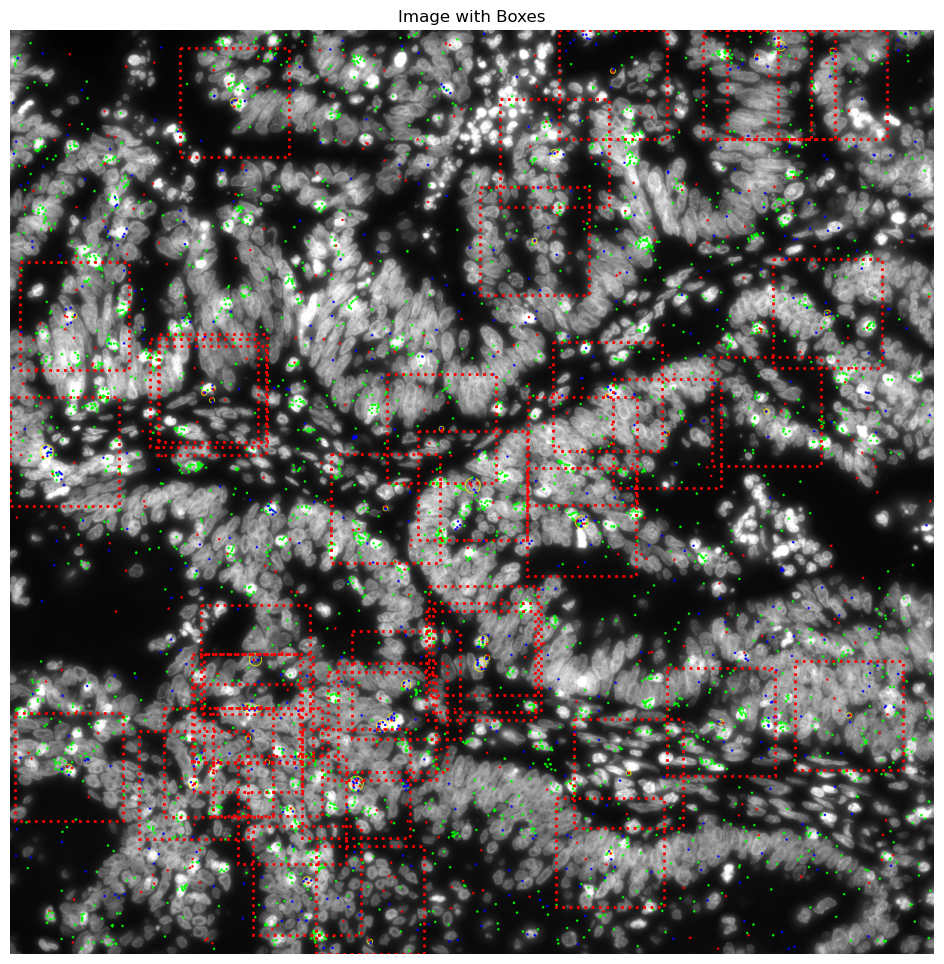

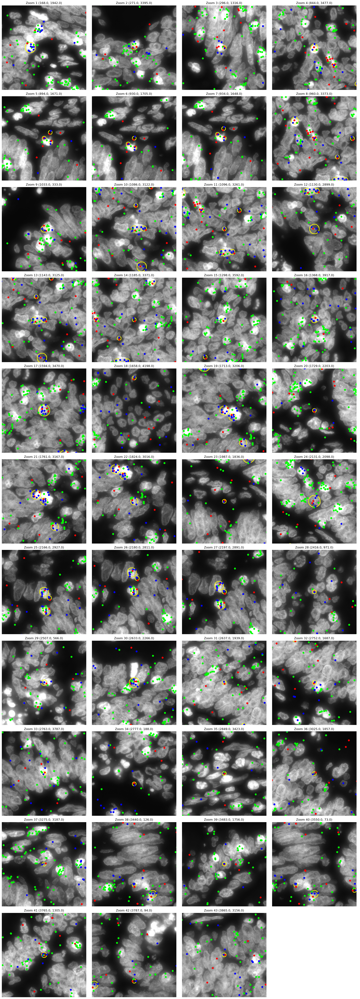

In [7]:
fov = 'FOV002'
file_csv = [file for file in files_cosmx if fov in file][0]  
    
df_total = pd.read_csv(file_csv)
df_total = df_total.rename(columns={'x': 'X', 'y': 'Y'})
df_total = df_total[~df_total['target'].str.contains('System|egative')]

n_genes = len(df_total['target'].unique())
height = int(max(df_total['X'])) + 1
width = int(max(df_total['Y'])) + 1


# this makes the sparse df to an array with the spatial information 
target_dict_total = {target: index for index, target in enumerate(df_total['target'].unique())}
array_total = ga.transform_df_to_array(df = df_total, target_dict=target_dict_total, array_shape = (height, width,len(target_dict_total))).astype(np.int8)

# creating subsets 
df_subset_gd, array_subset_gd, target_indices_subset_gd = ga.get_subset_arrays(df_total, array_total,
                                                                                   target_dict_total,
                                                                                   target_list=target_gd,
                                                                           target_col='target')

df_subset_ab, array_subset_ab, target_indices_subset_ab = ga.get_subset_arrays(df_total, array_total,
                                                                                       target_dict_total,
                                                                                       target_list=target_ab,
                                                                                       target_col='target')
    
    
df_subset_g, array_subset_g, target_indices_subset_g = ga.get_subset_arrays(df_total, array_total,
                                                                                       target_dict_total,
                                                                                       target_list=['TRGC1/TRGC2'],
                                                                                       target_col='target')
    
df_subset_d, array_subset_d, target_indices_subset_d = ga.get_subset_arrays(df_total, array_total,
                                                                                       target_dict_total,
                                                                                       target_list=['TRDC'],
                                                                                       target_col='target')



df_subset_gd = df_total[df_total['target'].isin(target_gd)]
CGD = contours.KDTreeContours(df_subset_gd, contour_name = 'gd', height=height, width = width)
CGD.find_points_with_neighoors(radius = 25, min_neighbours = 1)
CGD.get_contours_around_points_with_neighboors(type_contouring='simple_circle')

# ### Filtering 
CGD.filter_contours_by_gene_comparison(gene_array1 = array_subset_gd, gene_array2 = array_subset_ab,
                                       gene_name1 = "gd", gene_name2 = "ab") # gene 1 > gene2 --> valid contour 
# G>0 D>0
CGD.filter_contours_by_gene_threshold(gene_array = array_subset_d.squeeze(), threshold = 1, gene_name = 'TRDC')# >= 1
CGD.filter_contours_by_gene_threshold(gene_array = np.sum(array_subset_g, axis=-1), threshold = 1, gene_name = 'TRGC1_2')# >= 1



# centroids for GD
GM = get_masks.GetMasks(image_shape=(height, width))

SA = get_masks.SingleClassObjectAnalysis(GM, contours_object=CGD.contours)
SA.get_mask_objects(exclude_masks=None)  # Not excluding any tum or empty 

mask_GD = SA.mask_object_SA

morpho_properties= MorphologyExtractor().extract_per_object_features(labeled_mask= label(mask_GD))
centroids = [(obj['centroid_x'], obj['centroid_y']) for obj in morpho_properties]
centroids = [(float(y), float(x)) for (x, y) in centroids]


# image 


dapi_file = [file for file in os.listdir(dapi_folder) if str(fov[3:]) in file][0]
dapi_file_path = os.path.join(dapi_folder, dapi_file)
segmentation_file_path = f"../../cosmx_data/S3/S3/20230628_151317_S3/CellStatsDir/{fov}/CellLabels_F{fov[3:]}.tif"

target_list = ['TRGC1/TRGC2', 'TRDC','TRBC1/TRBC2', 'TRAC',] #  'CD8A','CD8B','CD4'
dapi_file = [file for file in os.listdir(dapi_folder) if str(fov[3:]) in file][0]
dapi_file_path = os.path.join(dapi_folder, dapi_file)
cell_counts = f"../../cosmx_data/S3/S3/20230628_151317_S3/AnalysisResults/yxyz3r7ufm/{fov}/Run_69de8227-1a7b-40ee-ba46-0ea99a7c59f4_{fov}__complete_code_cell_target_call_coord.csv"
cell_counts_df = pd.read_csv(cell_counts)
filtered_data = cell_counts_df[cell_counts_df['target'].isin(target_list)]
print(filtered_data['target'].value_counts())

img_gd_contour = plot_TRGC_TRDC_points_contours(CGD.contours, filtered_data, dapi_file_path)

    
plot_zoom_boxes_on_image(img_gd_contour, centroids, box_size = 500,num_cols = 4,
    show_titles = True, draw_boxes = True)

In [ ]:
# saving
# output_dir = "results/zoom_outputs"
# os.makedirs(output_dir, exist_ok=True)

# for idx, (left, upper, right, lower) in enumerate(zoom_coords):
#     cropped_img = img_gd_contour.crop((left, upper, right, lower))
    
#     # Save as PNG
#     output_path = os.path.join(output_dir, f"6_zoom_{idx + 1}.png")
#     cropped_img.save(output_path)
    
#     # Optionally display with annotation
#     cx, cy = centroids[idx]
#     plt.figure(figsize=(5, 5))
#     plt.imshow(cropped_img, origin='lower')
#     plt.axis('off')
#     plt.tight_layout()
#     plt.close()  